In [1]:
import pandas as pd

import re
import os
import scipy.misc
from PIL import Image, ImageFilter
import PIL
from skimage.color import rgb2gray
from scipy.signal import convolve
from sklearn.utils import shuffle
from skimage import io, transform
from keras.layers import Dense, GlobalAveragePooling2D
import matplotlib.pyplot as plt
from keras.models import Model
from keras import applications
from tqdm import tqdm
import numpy as np
import tensorflow as tf
import random
from __future__ import absolute_import, division
from IPython.display import clear_output
import cv2
import copy
!ls
%matplotlib inline

Using TensorFlow backend.


azure_benchmark.ipynb  facts	  save_folder  train_cropped
azure_remote2.0.ipynb  model1.h5  Test	       Untitled.ipynb
azure_remote.ipynb     model2.h5  Train        validation


# PREPARE TRAIN DATA

In [2]:
from keras import backend as K
config = tf.ConfigProto()
config.gpu_options.allow_growth=True
sess = tf.Session(config=config)
K.set_session(sess)

In [3]:
#All files in folder
reg = r'(\w+)\_pkw.samp'
INPUT_PATH='./Test/'
def extract_names(f):
    m = re.search(reg, f);
    if m is not None:
        return (f) ;
    
files = os.listdir(INPUT_PATH);
files = sorted(files)
names = map(extract_names, files)

In [4]:
only_cars = [name for name in names if name !=None]
only_cars_jpg = [item.split('_pkw.samp')[0]+'.JPG' for item in only_cars]

In [5]:
#float coords to int coords, need to draw cv2 rectangles
def integ(a):
    new =[]
    for item in a:
        new.append(int(float(item)))
    return new

In [6]:
out_fldr = 'Test/'
in_fldr  = './train_cropped/'

In [7]:
#PANDAS DATA_FRAME
pandas_files = pd.DataFrame(list(zip(only_cars, only_cars_jpg)),
              columns=['samp','jpg'])
pandas_files.head()

,samp,jpg
0,2012-04-26-Muenchen-Tunnel_4K0G0110_pkw.samp,2012-04-26-Muenchen-Tunnel_4K0G0110.JPG
1,2012-04-26-Muenchen-Tunnel_4K0G0120_pkw.samp,2012-04-26-Muenchen-Tunnel_4K0G0120.JPG
2,2012-04-26-Muenchen-Tunnel_4K0G0130_pkw.samp,2012-04-26-Muenchen-Tunnel_4K0G0130.JPG
3,2012-04-26-Muenchen-Tunnel_4K0G0140_pkw.samp,2012-04-26-Muenchen-Tunnel_4K0G0140.JPG
4,2012-04-26-Muenchen-Tunnel_4K0G0150_pkw.samp,2012-04-26-Muenchen-Tunnel_4K0G0150.JPG


In [8]:
#path_landmark = out_fldr + "2012-04-26-Muenchen-Tunnel_4K0G0010_pkw.samp"
def read_csv(path_landmark):
    names = ['id', 'type', 'center.x', 'center.y', 'size.width', 'size.height', 'alpha']
    cars_landmarks = pd.read_table(path_landmark, skiprows=6, delimiter=' ', names = names)
    return cars_landmarks

In [9]:
train = pd.DataFrame([])
for smp in pandas_files.samp:
    temp_pd = read_csv(out_fldr + smp)
    train = train.append(temp_pd, ignore_index=True)

In [10]:
def check_cross(aX, aY, bX, bY, aLen, bLen):
    return (aX < (bX + bLen) and (aX + aLen) > bX) and (aY < (bY - bLen) and (aY - aLen) > bY)

In [11]:
facts = pd.DataFrame([], columns=['index', 'target'])
spce = 30
ROWS = 60
COLS = 60
CHANNELS = 3

data = np.ndarray((969120, ROWS, COLS, CHANNELS), dtype=np.uint8)

counter = 0
for (smp, img) in tqdm(zip(pandas_files.samp, pandas_files.jpg)):
    img_input = np.array(Image.open('Test/' + img), np.uint8)
    path_landmark = 'Test/' + smp
    train_landmarks = read_csv(path_landmark)
    image = img_input.copy()
    if counter>1000:break
    
    for i, car in enumerate(train_landmarks.values):
        #print(car)
        temp_car = integ(car[2:6])
        #car
        x1 = temp_car[0] - spce
        y1 = temp_car[1] - spce
        x2 = temp_car[0] + spce
        y2 = temp_car[1] + spce
        image_array = img_input[y1:y2,x1:x2,:]
        if (image_array.shape[0]*image_array.shape[1] != ROWS*COLS):
            continue
        data[counter] = image_array
        df_temp = pd.DataFrame([[counter, 1]], columns=['index', 'target'])
        facts = facts.append(df_temp)
        counter+=1
        
        for j in range(0,2):
            shift_ = random.randint(-10,10)
            x1n = temp_car[0] - 2*spce + shift_
            y1n = temp_car[1] - 2*spce + shift_
            x2n = temp_car[0] + 2*spce + shift_
            y2n = temp_car[1] + 2*spce + shift_
            image_arrayn = img_input[y1n:y2n,x1n:x2n,:]
            if (image_arrayn.shape[0]*image_arrayn.shape[1] != 4*ROWS*COLS):
                continue
            
            alpha = random.randint(-360,360)
            im = Image.fromarray(np.uint8(image_arrayn))
            im = im.rotate(alpha)
            #cut off
            imaged = np.asarray(im)
            imaged = imaged[spce:3*spce, spce:3*spce, :]
            data[counter] = imaged
            df_temp = pd.DataFrame([[counter, 1]], columns=['index', 'target'])
            facts = facts.append(df_temp)
            counter+=1
            
            
#         im = Image.fromarray(np.uint8(image_array))
#         im = im.filter(ImageFilter.BLUR)
#         imaged = np.asarray(im)
#         data[counter] = imaged
#         df_temp = pd.DataFrame([[counter, 1]], columns=['index', 'target'])
#         facts = facts.append(df_temp)
#         counter+=1
        
        
#         im = Image.fromarray(np.uint8(image_array))
#         im = im.filter(ImageFilter.EDGE_ENHANCE)
#         imaged = np.asarray(im)
#         data[counter] = imaged
#         df_temp = pd.DataFrame([[counter, 1]], columns=['index', 'target'])
#         facts = facts.append(df_temp)
#         counter+=1
        
        
#         # shift each channel by 10 pixels
#         R = image_array[:,:,0]
#         G = image_array[:,:,1]
#         B = image_array[:,:,2]
#         RGBshifted = np.dstack( (
#             np.roll(R, 10, axis=0), 
#             np.roll(G, 10, axis=1), 
#             np.roll(B, -10, axis=0)
#             ))
#         data[counter] = RGBshifted
#         df_temp = pd.DataFrame([[counter, 1]], columns=['index', 'target'])
#         facts = facts.append(df_temp)
#         counter+=1
        
            
        

        #background
        #back_ground = img_input[x1:x2,y1:y2,:]
        for j in range(0,30):
            x_rnd = random.randint(spce, img_input.shape[1] - spce)#5616 +- space
            y_rnd = random.randint(spce, img_input.shape[0] - spce)#3744 +- space
            back_ground = img_input[y_rnd-spce:y_rnd+spce, x_rnd-spce:x_rnd+spce, :]
            check_counter = 0
            for s,cbl in enumerate(train_landmarks.values):
                check_car = integ(cbl[2:6])
                #car
                x01 = check_car[0] - spce
                y01 = check_car[1] - spce
                x02 = check_car[0] + spce
                y02 = check_car[1] + spce
                if (not (check_cross(x_rnd-spce, y_rnd-spce, x01, y01, 2*spce, 2*spce))):
                    check_counter+=1
            if check_counter==len(train_landmarks):
                data[counter] = back_ground
                df_temp = pd.DataFrame([[counter, 0]], columns=['index', 'target'])
                facts = facts.append(df_temp)
                counter+=1




        cv2.rectangle(image,(x1,y1),(x2,y2),(0,0,255),5)

#     plt.figure(figsize = (20,20))
#     plt.imshow(image)
#     plt.show()

 10%|█         | 1/10 [02:06<18:54, 126.03s/it]

In [12]:
from keras.models import Sequential
from keras.layers import Input, Dropout, Flatten, Conv2D, MaxPooling2D, Dense, Activation
from keras.optimizers import RMSprop, Adam
from keras.callbacks import ModelCheckpoint, Callback, EarlyStopping
from keras.utils import np_utils
from sklearn.model_selection import StratifiedKFold, cross_val_score
from keras.layers import Input, concatenate, Conv2D, MaxPooling2D, Conv2DTranspose
from keras import losses
import keras
from keras import backend as K
from keras import optimizers
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from keras.models import Sequential
from keras.layers import Input, Dropout, Flatten, Convolution2D, MaxPooling2D, Dense, Activation
from keras.optimizers import RMSprop
from keras.callbacks import ModelCheckpoint, Callback, EarlyStopping
from keras.utils import np_utils

In [13]:
# spce = 18
# ROWS = 36
# COLS = 36

In [14]:
y_train = facts['target'].values
x_train = data[:y_train.shape[0]]
#x_train = data[:y_train.shape[0],:,:,-1]
x_train = x_train.reshape(y_train.shape[0], ROWS, COLS, 3)
#x_train = x_train.reshape(x_train.shape[0], x_train.shape[3], x_train.shape[1], x_train.shape[2])

In [15]:
x_train.shape

(29835, 60, 60, 3)

In [16]:
y_train.shape

(29835,)

In [17]:
total_loss = []
class Metrics(keras.callbacks.Callback):
    def on_epoch_end(self, batch, logs={}):
        predict_proba = self.model.predict(self.validation_data[0])
        targ = self.validation_data[1].tolist()
        predict = (predict_proba>0.5).astype(int).ravel().tolist()
        self.f1s=f1_score(targ, predict)
        #print(type(predict), type(targ))
        total_loss.append(self.f1s)
        print(' fscore: {}'.format(self.f1s))
        return
f1_measure = Metrics()

In [18]:

    
model = Sequential()

model.add(Conv2D(32, (3, 3), padding="same", input_shape=(3, 60, 60), activation='relu' , data_format="channels_first"))
model.add(Conv2D(32, (3, 3), padding="same", activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))

model.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
model.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))

# model.add(Conv2D(128, (3, 3), border_mode='same', activation='relu'))
model.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
model.add(MaxPooling2D((2,2), strides=(2,2)))

model.add(Conv2D(256, (3, 3), padding='same', activation='relu'))
model.add(Conv2D(256, (3, 3), padding='same', activation='relu'))



model.add(MaxPooling2D((2,2), strides=(2,2)))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))

model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))

model.add(Dense(1))
model.add(Activation('sigmoid'))

In [19]:
class LossHistory(Callback):
    def on_train_begin(self, logs={}):
        self.losses = []

    def on_batch_end(self, batch, logs={}):
        #print (logs.get('loss'))
        self.losses.append(logs.get('loss'))

In [20]:
def f1(y_true, y_pred):
    def recall(y_true, y_pred):
        """Recall metric.

        Only computes a batch-wise average of recall.

        Computes the recall, a metric for multi-label classification of
        how many relevant items are selected.
        """
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
        recall = true_positives / (possible_positives + K.epsilon())
        return recall

    def precision(y_true, y_pred):
        """Precision metric.

        Only computes a batch-wise average of precision.

        Computes the precision, a metric for multi-label classification of
        how many selected items are relevant.
        """
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
        precision = true_positives / (predicted_positives + K.epsilon())
        return precision
    precision = precision(y_true, y_pred)
    recall = recall(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall))

In [21]:
#indexes
back_ind = list(facts[facts['target']==0]['index'].values)
car_ind = list(facts[facts['target']==1]['index'].values)

back_ind = map(int, back_ind)
car_ind = map(int, car_ind)

In [22]:
class PlotLosses(keras.callbacks.Callback):
    def on_train_begin(self, logs={}):
        self.i = 0
        self.x = []
        self.losses = []
        self.val_losses = []
        
        self.fig = plt.figure()
        
        self.logs = []

    def on_epoch_end(self, epoch, logs={}):
        
        self.logs.append(logs)
        self.x.append(self.i)
        self.losses.append(logs.get('loss'))
        self.val_losses.append(logs.get('val_loss'))
        self.i += 1
        
        clear_output(wait=True)
        plt.plot(self.x, self.losses, label="loss")
        plt.plot(self.x, self.val_losses, label="val_loss")
        plt.legend()
        plt.show();
        
plot_losses = PlotLosses()

In [23]:
len(car_ind)

2685

In [ ]:
nb_epoch = 10
batch_size = 1000
optimizer = Adam(lr=0.001)
objective = 'binary_crossentropy'

model.compile(loss=objective, optimizer=optimizer, metrics=[f1])
early_stopping = EarlyStopping(monitor='val_loss', patience=3, verbose=1, mode='auto')    
history = LossHistory()

for i in tqdm(range(0, len(back_ind)- len(car_ind), len(car_ind))):
    #k = random.randint(0,len(back_ind)- len(car_ind))
    train_ind = copy.deepcopy(back_ind[i:i+len(car_ind)])
    train_ind.extend(car_ind)
    train_shufl = shuffle(train_ind)
    X_t = x_train[train_shufl]
    y_t = y_train[train_shufl]
    model.fit(X_t, y_t, batch_size=batch_size, epochs=nb_epoch,
              validation_split=0.20, verbose=1, shuffle=True, callbacks=[history, early_stopping, f1_measure])

# CHECK

In [ ]:
y_proba = model.predict(x_train)

In [ ]:
f1_score(list((y_proba).astype(int).ravel()), list(y_train))

In [ ]:
from __future__ import division
max_ =0.0
adds= 0
for i in tqdm(range(0,1000)):
    rank = i/1000
    temp_score = f1_score(list((y_proba>rank).astype(int).ravel()), list(y_train))
    if temp_score>max_:
        max_= temp_score
        adds = rank

In [ ]:
adds

In [ ]:
img_input = np.array(Image.open("Train/2012-04-26-Muenchen-Tunnel_4K0G0010.JPG"), np.uint8)
path_landmark = "Train/2012-04-26-Muenchen-Tunnel_4K0G0010_pkw.samp"
train_landmarks = read_csv(path_landmark)

image = img_input.copy()
threshold = adds
#по x двигаюсь от (0, 5580)
#по y двигуюсь от (0, 3720)
for i in tqdm(range(0,5520,60)):
    for j in range(0,3660,60):
        x1 = j
        y1 = i
        x2 = j+60
        y2 = i+60
        #print(x1,y1)
        temp_image = image[x1:x2, y1:y2,:].reshape(1,3,60,60)
        pred_proba = model.predict(temp_image)[0]
        pred_prob = list(pred_proba)[0]
        if pred_prob>adds:
            cv2.rectangle(image,(x1,y1),(x2,y2),(0,0,255),5)
for i,car in enumerate(train_landmarks.values):
    #print(car)
    temp_car = integ(car[2:6])
    #car
    x1 = temp_car[0] - spce
    y1 = temp_car[1] - spce
    x2 = temp_car[0] + spce
    y2 = temp_car[1] + spce
    cv2.rectangle(image,(x1,y1),(x2,y2),(0,255,0),5)
plt.figure(figsize = (20,20))
plt.imshow(image)

# PERFORM ANOTHER MODEL

In [24]:
import numpy as np 
import pandas as pd 
import os
import cv2
from tqdm import tqdm

from keras.models import Sequential, Model
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, BatchNormalization, Input, merge, UpSampling2D, Cropping2D, ZeroPadding2D, Reshape, core, Convolution2D
from keras.callbacks import EarlyStopping, ModelCheckpoint, LearningRateScheduler
from keras import optimizers
from keras import backend as K
from keras.optimizers import SGD
from keras.layers.merge import concatenate

from sklearn.metrics import fbeta_score
from sklearn.model_selection import train_test_split

def get_crop_shape(target, refer):
        # width, the 3rd dimension
        cw = (target.get_shape()[2] - refer.get_shape()[2]).value
        assert (cw >= 0)
        if cw % 2 != 0:
            cw1, cw2 = int(cw/2), int(cw/2) + 1
        else:
            cw1, cw2 = int(cw/2), int(cw/2)
        # height, the 2nd dimension
        ch = (target.get_shape()[1] - refer.get_shape()[1]).value
        assert (ch >= 0)
        if ch % 2 != 0:
            ch1, ch2 = int(ch/2), int(ch/2) + 1
        else:
            ch1, ch2 = int(ch/2), int(ch/2)

        return (ch1, ch2), (cw1, cw2)

In [25]:
def get_unet(n_ch, patch_height,patch_width):
    concat_axis = 3

    inputs = Input((patch_height, patch_width, n_ch))
    
    conv1 = Conv2D(32, (3, 3), padding="same", name="conv1_1", activation="relu", data_format="channels_last")(inputs)
    conv1 = Conv2D(32, (3, 3), padding="same", activation="relu", data_format="channels_last")(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2), data_format="channels_last")(conv1)
    conv2 = Conv2D(64, (3, 3), padding="same", activation="relu", data_format="channels_last")(pool1)
    conv2 = Conv2D(64, (3, 3), padding="same", activation="relu", data_format="channels_last")(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2), data_format="channels_last")(conv2)

    conv3 = Conv2D(128, (3, 3), padding="same", activation="relu", data_format="channels_last")(pool2)
    conv3 = Conv2D(128, (3, 3), padding="same", activation="relu", data_format="channels_last")(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2), data_format="channels_last")(conv3)

    conv4 = Conv2D(256, (3, 3), padding="same", activation="relu", data_format="channels_last")(pool3)
    conv4 = Conv2D(256, (3, 3), padding="same", activation="relu", data_format="channels_last")(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2), data_format="channels_last")(conv4)

    conv5 = Conv2D(512, (3, 3), padding="same", activation="relu", data_format="channels_last")(pool4)
    conv5 = Conv2D(512, (3, 3), padding="same", activation="relu", data_format="channels_last")(conv5)

    up_conv5 = UpSampling2D(size=(2, 2), data_format="channels_last")(conv5)
    ch, cw = get_crop_shape(conv4, up_conv5)
    crop_conv4 = Cropping2D(cropping=(ch,cw), data_format="channels_last")(conv4)
    up6   = concatenate([up_conv5, crop_conv4], axis=concat_axis)
    conv6 = Conv2D(256, (3, 3), padding="same", activation="relu", data_format="channels_last")(up6)
    conv6 = Conv2D(256, (3, 3), padding="same", activation="relu", data_format="channels_last")(conv6)

    up_conv6 = UpSampling2D(size=(2, 2), data_format="channels_last")(conv6)
    ch, cw = get_crop_shape(conv3, up_conv6)
    crop_conv3 = Cropping2D(cropping=(ch,cw), data_format="channels_last")(conv3)
    up7   = concatenate([up_conv6, crop_conv3], axis=concat_axis)
    conv7 = Conv2D(128, (3, 3), padding="same", activation="relu", data_format="channels_last")(up7)
    conv7 = Conv2D(128, (3, 3), padding="same", activation="relu", data_format="channels_last")(conv7)

    up_conv7 = UpSampling2D(size=(2, 2), data_format="channels_last")(conv7)
    ch, cw = get_crop_shape(conv2, up_conv7)
    crop_conv2 = Cropping2D(cropping=(ch,cw), data_format="channels_last")(conv2)
    up8   = concatenate([up_conv7, crop_conv2], axis=concat_axis)
    conv8 = Conv2D(64, (3, 3), padding="same", activation="relu", data_format="channels_last")(up8)
    conv8 = Conv2D(64, (3, 3), padding="same", activation="relu", data_format="channels_last")(conv8)

    up_conv8 = UpSampling2D(size=(2, 2), data_format="channels_last")(conv8)
    ch, cw = get_crop_shape(conv1, up_conv8)
    crop_conv1 = Cropping2D(cropping=(ch,cw), data_format="channels_last")(conv1)
    up9   = concatenate([up_conv8, crop_conv1], axis=concat_axis)
    conv9 = Conv2D(32, (3, 3), padding="same", activation="relu", data_format="channels_last")(up9)
    conv9 = Conv2D(32, (3, 3), padding="same", activation="relu", data_format="channels_last")(conv9)

    #ch, cw = get_crop_shape(inputs, conv9)
    #conv9  = ZeroPadding2D(padding=(ch[0],cw[0]), data_format="channels_last")(conv9)
    #conv10 = Conv2D(1, (1, 1), data_format="channels_last", activation="sigmoid")(conv9)
    
    flatten =  Flatten()(conv9)
    Dense1 = Dense(512, activation='relu')(flatten)
    BN =BatchNormalization() (Dense1)
    Dense2 = Dense(1, activation='sigmoid')(BN)
    
    model = Model(inputs=inputs, outputs=Dense2)
    
    return model

In [26]:
model1 = get_unet(3, ROWS, COLS)

In [27]:
model1.load_weights('model1.h5')

In [39]:
nb_epoch = 1
batch_size = 500
optimizer = Adam(lr=0.001)
objective = 'binary_crossentropy'

model1.compile(loss=objective, optimizer=optimizer, metrics=[f1])
early_stopping = EarlyStopping(monitor='val_loss', patience=5, verbose=1, mode='auto')    
history = LossHistory()
for i in range(0,10):
    back_ind_shul = copy.deepcopy(back_ind)
    back_ind_shul = shuffle(back_ind_shul)
    for i in tqdm(range(0, len(back_ind)- 2*len(car_ind), 2*len(car_ind))):
        train_ind = copy.deepcopy(back_ind_shul[i:i+2*len(car_ind)])
        train_ind.extend(car_ind)
        train_shufl = shuffle(train_ind)
        X_t = x_train[train_shufl]
        y_t = y_train[train_shufl]
        model1.fit(X_t, y_t, batch_size=batch_size, epochs=nb_epoch,
                  validation_split=0.20, verbose=1, shuffle=True, callbacks=[history, early_stopping, f1_measure])

        #train until good
        if total_loss[-1]<0.97:
            successful = False
            print('AGAIN')
        else:
            successful = True
        while not successful:        
            model1.fit(X_t, y_t, batch_size=batch_size, epochs=nb_epoch,
                  validation_split=0.20, verbose=1, shuffle=True, callbacks=[history, early_stopping, f1_measure])
            if total_loss[-1]>0.97:
                successful = True
            else:
                print('AGAIN')


  0%|          | 0/5 [00:00<?, ?it/s]

Train on 39964 samples, validate on 9992 samples
Epoch 1/1
 3500/39964 [=>............................] - ETA: 1:15 - loss: 0.0543 - f1: 0.9818


Exception in thread Thread-5:
Traceback (most recent call last):
  File "/home/john/anaconda2/lib/python2.7/threading.py", line 801, in __bootstrap_inner
    self.run()
  File "/home/john/anaconda2/lib/python2.7/site-packages/tqdm/_tqdm.py", line 144, in run
    for instance in self.tqdm_cls._instances:
  File "/home/john/anaconda2/lib/python2.7/_weakrefset.py", line 60, in __iter__
    for itemref in self.data:
RuntimeError: Set changed size during iteration



39964/39964 [==============================] - 85s 2ms/step - loss: 0.0452 - f1: 0.9824 - val_loss: 0.1446 - val_f1: 0.9339
AGAIN
Train on 39964 samples, validate on 9992 samples
Epoch 1/1
39964/39964 [==============================] - 85s 2ms/step - loss: 0.0227 - f1: 0.9904 - val_loss: 0.0567 - val_f1: 0.9784



 20%|██        | 1/5 [02:52<11:28, 172.05s/it]

Train on 39964 samples, validate on 9992 samples
Epoch 1/1
39964/39964 [==============================] - 86s 2ms/step - loss: 0.0303 - f1: 0.9870 - val_loss: 0.0525 - val_f1: 0.9797



 40%|████      | 2/5 [04:17<06:26, 128.92s/it]

Train on 39964 samples, validate on 9992 samples
Epoch 1/1
39964/39964 [==============================] - 86s 2ms/step - loss: 0.0289 - f1: 0.9879 - val_loss: 0.0314 - val_f1: 0.9889



 60%|██████    | 3/5 [05:44<03:49, 114.75s/it]

Train on 39964 samples, validate on 9992 samples
Epoch 1/1
39964/39964 [==============================] - 86s 2ms/step - loss: 0.0261 - f1: 0.9893 - val_loss: 0.1258 - val_f1: 0.9549
AGAIN
Train on 39964 samples, validate on 9992 samples
Epoch 1/1
39964/39964 [==============================] - 86s 2ms/step - loss: 0.0137 - f1: 0.9942 - val_loss: 0.0457 - val_f1: 0.9763



 80%|████████  | 4/5 [08:36<02:09, 129.15s/it]

Train on 39964 samples, validate on 9992 samples
Epoch 1/1
39964/39964 [==============================] - 86s 2ms/step - loss: 0.0247 - f1: 0.9890 - val_loss: 0.0937 - val_f1: 0.9646
AGAIN
Train on 39964 samples, validate on 9992 samples
Epoch 1/1
39964/39964 [==============================] - 86s 2ms/step - loss: 0.0108 - f1: 0.9959 - val_loss: 0.0270 - val_f1: 0.9881



  0%|          | 0/5 [00:00<?, ?it/s]

Train on 39964 samples, validate on 9992 samples
Epoch 1/1
 1500/39964 [>.............................] - ETA: 1:10 - loss: 0.0139 - f1: 0.9949

KeyboardInterrupt: 

In [40]:
model1.save_weights("model2.h5")
print("Saved model to disk")

Saved model to disk


# CHECK AGAIN 

In [28]:
y_proba = model1.predict(x_train)

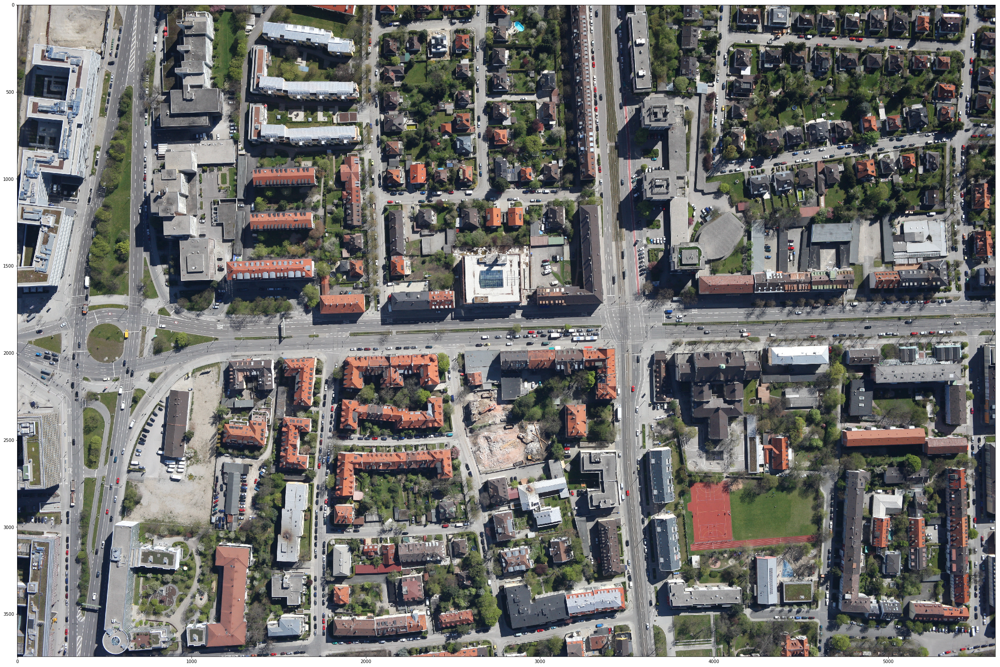

In [31]:
img_input = np.array(Image.open("Test/2012-04-26-Muenchen-Tunnel_4K0G0110.JPG"), np.uint8)
plt.figure(figsize = (40,40))
plt.imshow(img_input)

In [51]:
f1_score(list((y_proba>0.91).astype(int).ravel()), list(y_train))

0.90981281905842326

In [48]:
from __future__ import division
max_ =0.0
adds= 0
f1_list = []
thread_list = []
for i in tqdm(range(0,100)):
    rank = i/100
    thread_list.append(rank)
    temp_score = f1_score(list((y_proba>rank).astype(int).ravel()), list(y_train), average='macro')
    f1_list.append(temp_score)
    if temp_score>max_:
        max_= temp_score
        adds = rank
adds


  0%|          | 0/100 [00:00<?, ?it/s]/home/john/anaconda2/lib/python2.7/site-packages/sklearn/metrics/classification.py:1137: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)

100%|██████████| 100/100 [00:02<00:00, 43.68it/s]


0.84

[0.7, 1.0, 0.0, 1.0]

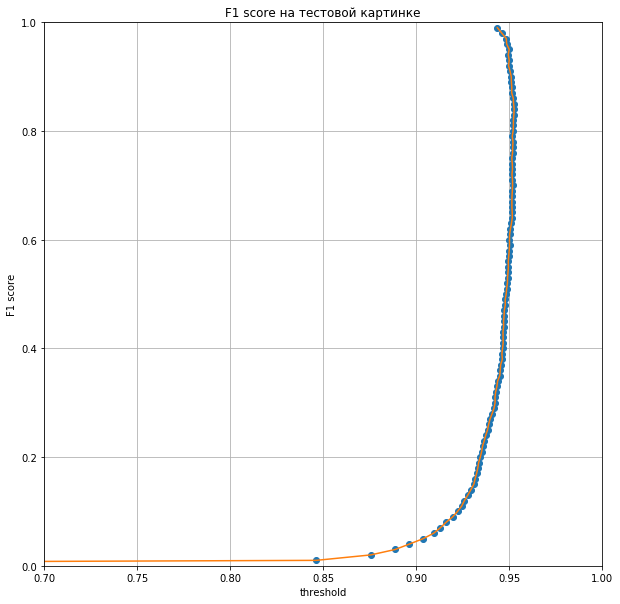

In [49]:
plt.figure(figsize = (10,10))
plt.ylabel('F1 score')
plt.xlabel('threshold')
plt.title(u'F1 score на тестовой картинке')
plt.grid(True)
plt.plot(f1_list, thread_list, 'o')
plt.plot(f1_list, thread_list)
plt.axis([0.7,1.0,0.0,1.0])

In [84]:
from sklearn.metrics import precision_recall_curve

In [91]:
precision, recall, thresholds = precision_recall_curve(y_train, list((y_proba>0.1).astype(int).ravel()))

In [92]:
from sklearn.metrics import average_precision_score
average_precision = average_precision_score(y_train, list((y_proba>0.84).astype(int).ravel()))

Text(0.5,1,u'2-class Precision-Recall curve: AP=0.84')

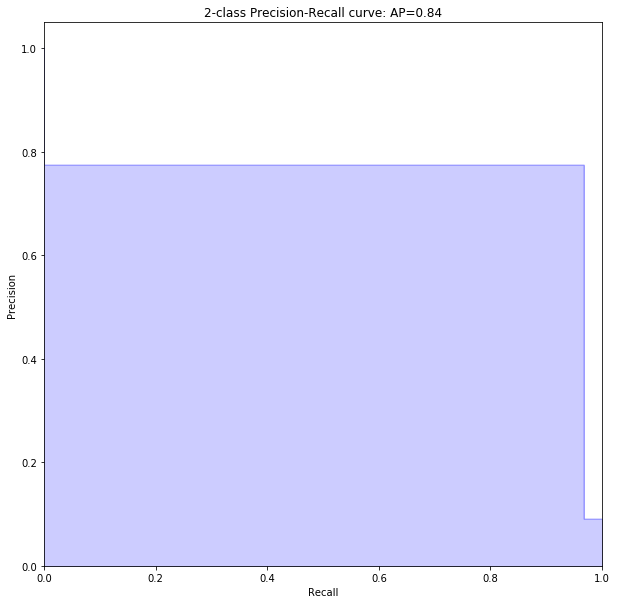

In [93]:
plt.figure(figsize = (10,10))
plt.step(recall, precision, color='b', alpha=0.2,
         where='post')
plt.fill_between(recall, precision, step='post', alpha=0.2,
                 color='b')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.ylim([0.0, 1.05])
plt.xlim([0.0, 1.0])
plt.title('2-class Precision-Recall curve: AP={0:0.2f}'.format(
          average_precision))

In [ ]:
list(model1.predict_on_batch(temp_image)[0].astype(int))[0]

In [127]:
img_input = np.array(Image.open("Test/2012-04-26-Muenchen-Tunnel_4K0G0285.JPG"), np.uint8)
path_landmark = "Test/2012-04-26-Muenchen-Tunnel_4K0G0285_pkw.samp"
train_landmarks = read_csv(path_landmark)

image = img_input.copy()
#по x двигаюсь от (0, 5580)
#по y двигуюсь от (0, 3720)


#(3744, 5616, 3)
#cv2.rectangle(image,(x1,y1),(x2,y2),(0,0,255),5)
for i in tqdm(range(0,5550,46)):
    for j in range(0,3390,46):
        x1 = i
        y1 = j
        x2 = i+COLS
        y2 = j+COLS
        temp_image = image[y1:y2, x1:x2,:].reshape(1, ROWS, COLS, 3)
        
        pred_proba = model1.predict(temp_image)[0]
        pred_prob = list(pred_proba)[0]
#         eq  = list(model1.predict_on_batch(temp_image)[0].astype(int))[0]
#         if eq==1:
        if pred_prob>0.99:
            cv2.rectangle(image,(x1,y1),(x2,y2),(0,0,255),10)
# plt.figure(figsize = (40,40))
# plt.imshow(image)

100%|██████████| 121/121 [00:49<00:00,  2.44it/s]


In [126]:
from PIL import Image, ImageFile

#ImageFile.MAXBLOCK = 2**20
img = Image.fromarray(np.uint8(image))

img.save("out9.jpg", "JPEG", quality=80, optimize=True, progressive=True)

In [97]:

a = Image.open("out1.jpg")

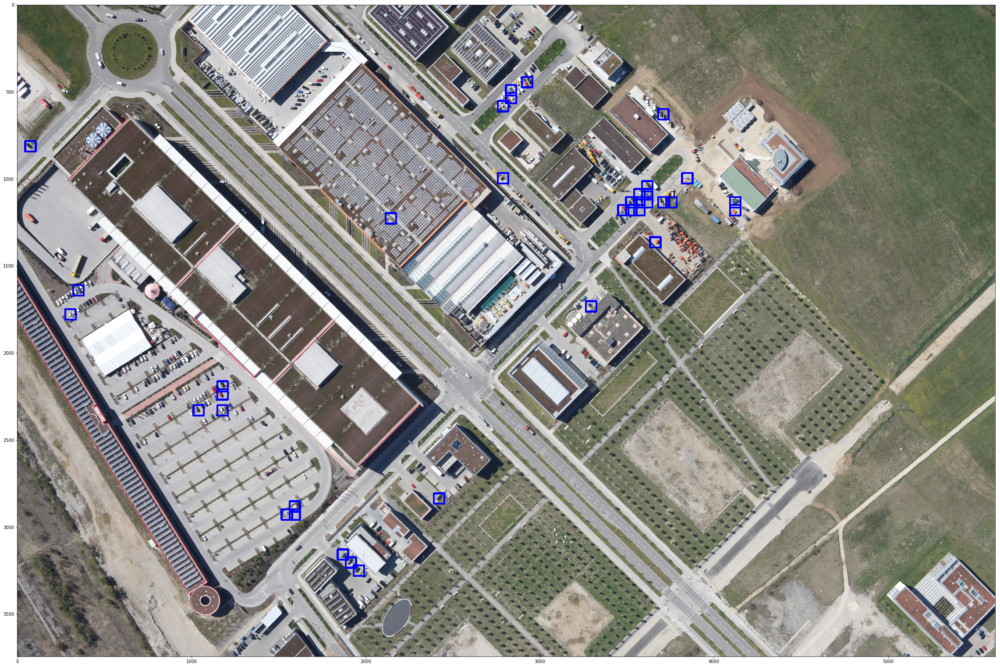

In [128]:
plt.figure(figsize = (40,40))
plt.imshow(image)

In [65]:
# import the necessary packages
import imutils
 
def pyramid(image, scale=1.5, minSize=(60, 60)):
	# yield the original image
	yield image
 
	# keep looping over the pyramid
	while True:
		# compute the new dimensions of the image and resize it
		w = int(image.shape[1] / scale)
		image = imutils.resize(image, width=w)
 
		# if the resized image does not meet the supplied minimum
		# size, then stop constructing the pyramid
		if image.shape[0] < minSize[1] or image.shape[1] < minSize[0]:
			break
 
		# yield the next image in the pyramid
		yield image
        
def sliding_window(image, stepSize, windowSize):
	# slide a window across the image
	for y in xrange(0, image.shape[0], stepSize):
		for x in xrange(0, image.shape[1], stepSize):
			# yield the current window
			yield (x, y, image[y:y + windowSize[1], x:x + windowSize[0]])

In [ ]:
# import the necessary packages
import argparse
import time
import cv2
 

# load the image and define the window width and height
image = cv2.imread("Test/2012-04-26-Muenchen-Tunnel_4K0G0110.JPG")
(winW, winH) = (60, 60)

In [ ]:
# loop over the image pyramid
for resized in pyramid(image, scale=1.5):
	# loop over the sliding window for each layer of the pyramid
	for (x, y, window) in sliding_window(resized, stepSize=32, windowSize=(winW, winH)):
		# if the window does not meet our desired window size, ignore it
		if window.shape[0] != winH or window.shape[1] != winW:
			continue
 
		# THIS IS WHERE YOU WOULD PROCESS YOUR WINDOW, SUCH AS APPLYING A
		# MACHINE LEARNING CLASSIFIER TO CLASSIFY THE CONTENTS OF THE
		# WINDOW
 
		# since we do not have a classifier, we'll just draw the window
		clone = resized.copy()
		cv2.rectangle(clone, (x, y), (x + winW, y + winH), (0, 255, 0), 2)
		cv2.imshow("Window", clone)
		cv2.waitKey(1)
		time.sleep(0.025)

In [53]:
X.shape

(29835, 60, 60, 3)

In [56]:
print(__doc__)

import numpy as np
from scipy import interp
import matplotlib.pyplot as plt
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import StratifiedKFold

# #############################################################################
# Data IO and generation

# Import some data to play with

X = x_train
y = y_train
n_samples, n_features = X.shape[0], X.shape[1]*X.shape[2]

# Add noisy features
#random_state = np.random.RandomState(0)
#X = np.c_[X, random_state.randn(n_samples, 200 * n_features)]

# #############################################################################
# Classification and ROC analysis

# Run classifier with cross-validation and plot ROC curves
cv = StratifiedKFold(n_splits=6)
classifier = svm.SVC(kernel='linear', probability=True,
                     random_state=random_state)

tprs = []
aucs = []
mean_fpr = np.linspace(0, 1, 100)

i = 0
for train, test in cv.split(X, y):
    probas_ = model1.predict_proba(X[test])
    # Compute ROC curve and area the curve
    fpr, tpr, thresholds = roc_curve(y[test], probas_[:, 1])
    tprs.append(interp(mean_fpr, fpr, tpr))
    tprs[-1][0] = 0.0
    roc_auc = auc(fpr, tpr)
    aucs.append(roc_auc)
    plt.plot(fpr, tpr, lw=1, alpha=0.3,
             label='ROC fold %d (AUC = %0.2f)' % (i, roc_auc))

    i += 1
plt.plot([0, 1], [0, 1], linestyle='--', lw=2, color='r',
         label='Luck', alpha=.8)

mean_tpr = np.mean(tprs, axis=0)
mean_tpr[-1] = 1.0
mean_auc = auc(mean_fpr, mean_tpr)
std_auc = np.std(aucs)
plt.plot(mean_fpr, mean_tpr, color='b',
         label=r'Mean ROC (AUC = %0.2f $\pm$ %0.2f)' % (mean_auc, std_auc),
         lw=2, alpha=.8)

std_tpr = np.std(tprs, axis=0)
tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
tprs_lower = np.maximum(mean_tpr - std_tpr, 0)
plt.fill_between(mean_fpr, tprs_lower, tprs_upper, color='grey', alpha=.2,
                 label=r'$\pm$ 1 std. dev.')

plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

Automatically created module for IPython interactive environment


RuntimeError: You must compile a model before training/testing. Use `model.compile(optimizer, loss)`.

In [ ]:
'''
TODO:
когда бежишься окном, дообучать алгортим. Смотреть на пересечения с ответом.
Либо в трейновую выборку добавить по 4ре смещенные по разным осям картинки на 10 пикселей

'''


# Up, down, left-up, right-down, left, right. Make more data

In [ ]:
old_counter = copy.deepcopy(counter)

In [ ]:
x_train.shape

In [ ]:
facts.shape

In [ ]:
drop_ind = list(np.array([i for i in range(743875,749173)]).astype(float))

In [ ]:
facts.drop(facts['index'][drop_ind])

In [ ]:
spc_list = [5,10]

for (smp, img) in tqdm(zip(pandas_files.samp, pandas_files.jpg)):
    img_input = np.array(Image.open('Train/' + img), np.uint8)
    path_landmark = 'Train/' + smp
    train_landmarks = read_csv(path_landmark)
    image = img_input.copy()
    
    for i, car in enumerate(train_landmarks.values):
        #print(car)
        temp_car = integ(car[2:6])
        #car
        x1 = temp_car[0] - spce
        y1 = temp_car[1] - spce
        x2 = temp_car[0] + spce
        y2 = temp_car[1] + spce
############################# LEFT-UP        
        for sp in spc_list:
            x1u = x1 - sp
            y1u = y1 - sp
            x2u = x2 - sp
            y2u = y2 - sp
            image_array = img_input[y1u:y2u,x1u:x2u,:]
            if (image_array.shape[0]*image_array.shape[1] != ROWS*COLS):
                break
            data[counter] = image_array
            df_temp = pd.DataFrame([[counter, 1]], columns=['index', 'target'])
            facts = facts.append(df_temp)
            counter+=1
        
            for j in range(0,2):
                x1n = x1u - spce
                y1n = y1u - spce
                x2n = x2u + spce
                y2n = y2u + spce
                image_arrayn = img_input[y1n:y2n,x1n:x2n,:]
                if (image_arrayn.shape[0]*image_arrayn.shape[1] != 4*ROWS*COLS):
                    continue

                alpha = random.randint(-360,360)
                im = Image.fromarray(np.uint8(image_arrayn))
                im = im.rotate(alpha)
                #cut off
                imaged = np.asarray(im)
                imaged = imaged[spce:3*spce, spce:3*spce, :]
                data[counter] = imaged
                df_temp = pd.DataFrame([[counter, 1]], columns=['index', 'target'])
                facts = facts.append(df_temp)
                counter+=1
                
        plt.imshow(image_array)
        plt.show()

        plt.imshow(imaged)
        plt.show()
            
################################## RIGHT-DOWN        
        for sp in spc_list:
            x1u = x1 + sp
            y1u = y1 + sp
            x2u = x2 + sp
            y2u = y2 + sp
            image_array = img_input[y1u:y2u,x1u:x2u,:]
            if (image_array.shape[0]*image_array.shape[1] != ROWS*COLS):
                continue
            data[counter] = image_array
            df_temp = pd.DataFrame([[counter, 1]], columns=['index', 'target'])
            facts = facts.append(df_temp)
            counter+=1

            for j in range(0,2):
                x1n = x1u - spce
                y1n = y1u - spce
                x2n = x2u + spce
                y2n = y2u + spce
                image_arrayn = img_input[y1n:y2n,x1n:x2n,:]
                if (image_arrayn.shape[0]*image_arrayn.shape[1] != 4*ROWS*COLS):
                    continue

                alpha = random.randint(-360,360)
                im = Image.fromarray(np.uint8(image_arrayn))
                im = im.rotate(alpha)
                #cut off
                imaged = np.asarray(im)
                imaged = imaged[spce:3*spce, spce:3*spce, :]
                data[counter] = imaged
                df_temp = pd.DataFrame([[counter, 1]], columns=['index', 'target'])
                facts = facts.append(df_temp)
                
                
                counter+=1

####################### UP            
        for sp in spc_list:
            x1u = x1 
            y1u = y1 + sp
            x2u = x2
            y2u = y2 + sp
            image_array = img_input[y1u:y2u,x1u:x2u,:]
            if (image_array.shape[0]*image_array.shape[1] != ROWS*COLS):
                continue
            data[counter] = image_array
            df_temp = pd.DataFrame([[counter, 1]], columns=['index', 'target'])
            facts = facts.append(df_temp)
            counter+=1

            for j in range(0,2):
                x1n = x1u - spce
                y1n = y1u - spce
                x2n = x2u + spce
                y2n = y2u + spce
                image_arrayn = img_input[y1n:y2n,x1n:x2n,:]
                if (image_arrayn.shape[0]*image_arrayn.shape[1] != 4*ROWS*COLS):
                    continue

                alpha = random.randint(-360,360)
                im = Image.fromarray(np.uint8(image_arrayn))
                im = im.rotate(alpha)
                #cut off
                imaged = np.asarray(im)
                imaged = imaged[spce:3*spce, spce:3*spce, :]
                data[counter] = imaged
                df_temp = pd.DataFrame([[counter, 1]], columns=['index', 'target'])
                facts = facts.append(df_temp)
                counter+=1

###################  DOWN
        for sp in spc_list:
            x1u = x1 
            y1u = y1 - sp
            x2u = x2
            y2u = y2 - sp
            image_array = img_input[y1u:y2u,x1u:x2u,:]
            if (image_array.shape[0]*image_array.shape[1] != ROWS*COLS):
                continue
            data[counter] = image_array
            df_temp = pd.DataFrame([[counter, 1]], columns=['index', 'target'])
            facts = facts.append(df_temp)
            counter+=1

            for j in range(0,2):
                x1n = x1u - spce
                y1n = y1u - spce
                x2n = x2u + spce
                y2n = y2u + spce
                image_arrayn = img_input[y1n:y2n,x1n:x2n,:]
                if (image_arrayn.shape[0]*image_arrayn.shape[1] != 4*ROWS*COLS):
                    continue

                alpha = random.randint(-360,360)
                im = Image.fromarray(np.uint8(image_arrayn))
                im = im.rotate(alpha)
                #cut off
                imaged = np.asarray(im)
                imaged = imaged[spce:3*spce, spce:3*spce, :]
                data[counter] = imaged
                df_temp = pd.DataFrame([[counter, 1]], columns=['index', 'target'])
                facts = facts.append(df_temp)
                counter+=1
            

In [ ]:
y_train_new = facts['target'].values
x_train_new = data[:y_train_new.shape[0]]
x_train_new = x_train_new.reshape(y_train_new.shape[0], ROWS, COLS, 3)

In [ ]:
new_car_len =counter - old_counter

In [ ]:
for i in range(0,10):
    back_ind_shul = copy.deepcopy(back_ind)
    back_ind_shul = shuffle(back_ind_shul)
    for i in tqdm(range(0, len(back_ind)- 2*len(new_car_len), 2*len(new_car_len))):
        
        train_ind = copy.deepcopy(back_ind_shul[i:i+2*len(new_car_len)])
        new_car_ind = [[i for i in range(old_counter, counter)]]
        
        train_ind.extend(new_car_ind)
        train_shufl = shuffle(train_ind)
        
        X_t = y_train_new[train_shufl]
        y_t = x_train_new[train_shufl]
        
        model1.fit(X_t, y_t, batch_size=batch_size, epochs=nb_epoch,
                  validation_split=0.20, verbose=1, shuffle=True, callbacks=[history, early_stopping, f1_measure])

        #train until good
        if total_loss[-1]<0.98:
            successful = False
            print('AGAIN')
        else:
            successful = True
        while not successful:        
            model1.fit(X_t, y_t, batch_size=batch_size, epochs=nb_epoch,
                  validation_split=0.20, verbose=1, shuffle=True, callbacks=[history, early_stopping, f1_measure])
            if total_loss[-1]>0.98:
                successful = True
            else:
                print('AGAIN')